In [22]:
from ultralytics import YOLO
import cv2
from PIL import Image
import numpy as np
from datetime import datetime
from transformers import TrOCRProcessor, VisionEncoderDecoderModel
import torch

In [23]:
model=YOLO("../model/number_plate_detect/best.pt")


In [24]:
def get_plate(images):
    
    results=model.predict(images,show_boxes=True,save=True,conf=0.25)
    rs=[]
    for result in results:
        for box in result.boxes:
            left, top, right, bottom = np.array(box.xyxy.cpu(), dtype=np.int32).squeeze()
            region=result.orig_img[top: bottom,left:right]
            now=datetime.now()
            filename="results/result"+str(now.strftime("%Y%m%d%H%M%S"))+"_"+str(len(rs))+".png"
            print(filename)
            cv2.imwrite(filename,region)
            
            rs.append(filename)

    return rs

In [25]:
r=get_plate("college_data/")


image 1/113 C:\Users\2411c\Desktop\mini\testing\college_data\IMG-20240806-WA0002.jpg: 256x320 1 Plate, 186.4ms
image 2/113 C:\Users\2411c\Desktop\mini\testing\college_data\IMG-20240806-WA0003.jpg: 256x320 1 Plate, 175.5ms
image 3/113 C:\Users\2411c\Desktop\mini\testing\college_data\IMG-20240806-WA0004.jpg: 256x320 2 Plates, 202.3ms
image 4/113 C:\Users\2411c\Desktop\mini\testing\college_data\IMG-20240806-WA0005.jpg: 256x320 1 Plate, 159.7ms
image 5/113 C:\Users\2411c\Desktop\mini\testing\college_data\IMG-20240806-WA0006.jpg: 256x320 1 Plate, 150.5ms
image 6/113 C:\Users\2411c\Desktop\mini\testing\college_data\IMG-20240806-WA0007.jpg: 256x320 2 Plates, 169.4ms
image 7/113 C:\Users\2411c\Desktop\mini\testing\college_data\IMG-20240806-WA0008.jpg: 256x320 1 Plate, 161.1ms
image 8/113 C:\Users\2411c\Desktop\mini\testing\college_data\IMG-20240806-WA0009.jpg: 256x320 3 Plates, 162.4ms
image 9/113 C:\Users\2411c\Desktop\mini\testing\college_data\IMG-20240806-WA0010.jpg: 256x320 1 Plate, 155.0

In [26]:
import torch_directml

In [27]:
ocr_model =  VisionEncoderDecoderModel.from_pretrained("../model/vit_ocr/trocr-small-pretrained")
processor = TrOCRProcessor.from_pretrained("../model/vit_ocr/trocr-small-pretrained")

In [28]:

def extract_text(img):

    
    image = cv2.imread(np)
    
    pixel_values = processor(image, return_tensors="pt").pixel_values

    if torch.cuda.is_available():#NVIDIA GPU
        device = torch.device("cuda:0")
    elif torch_directml.device():#FOR AMD GPU
        device=torch_directml.device()
    else:#FOR CPU
        device=torch.device("cpu")
    
        
    pixel_values = pixel_values.to(device)
    ocr_model.to(device)
    
    generated_ids = ocr_model.generate(pixel_values)
    generated_text = processor.batch_decode(generated_ids, skip_special_tokens=True)[0]
    
    number_plate=""
    for ch in generated_text:
        if ch.isalnum():
            number_plate+=ch
    print(number_plate)
    return number_plate

In [29]:
import matplotlib.pyplot as plt
%matplotlib inline

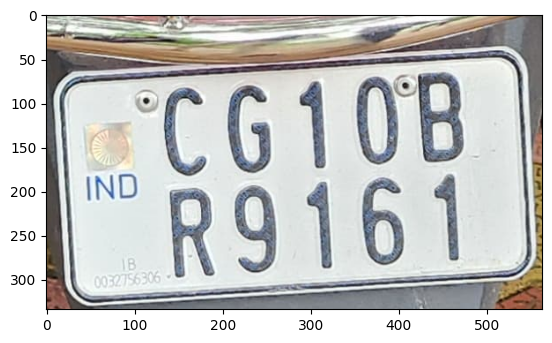

REF


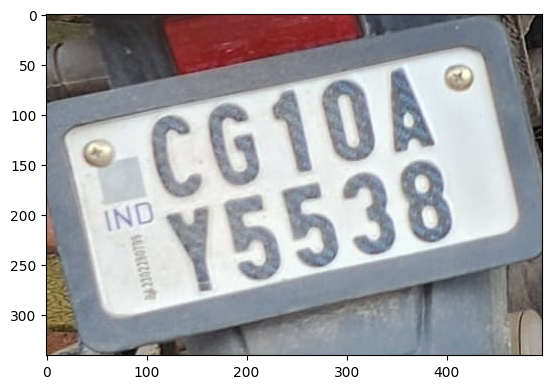

THAN


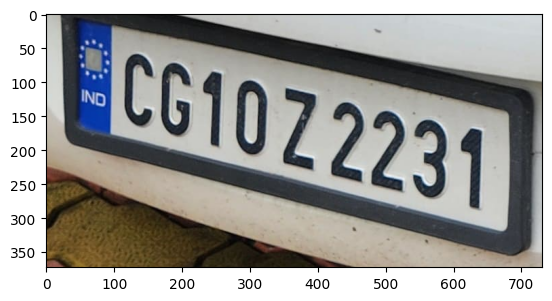

0010722331


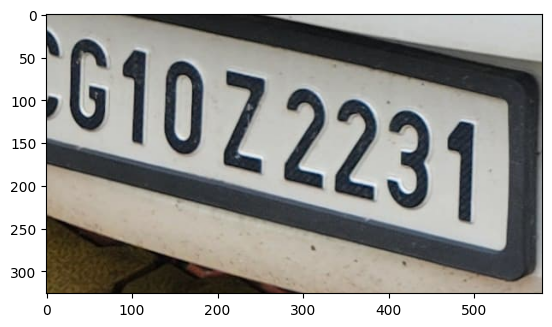

10722231


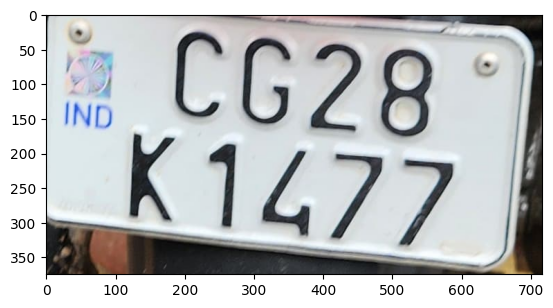

GST


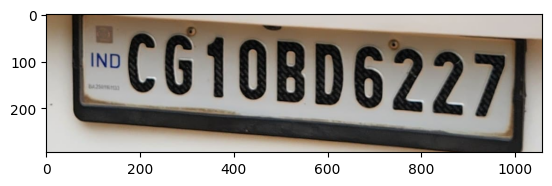

CG10BD6227


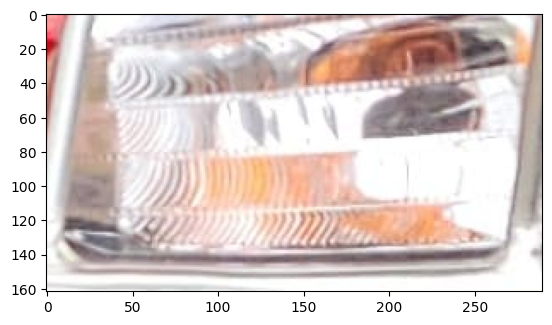

REF


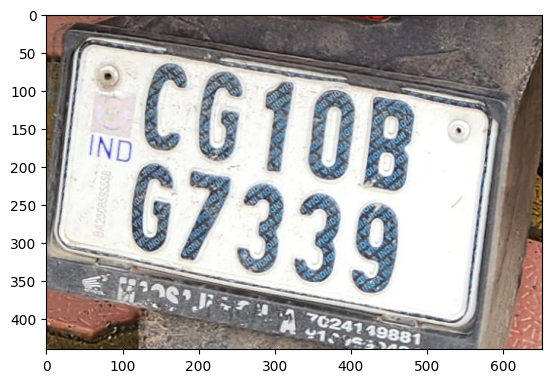

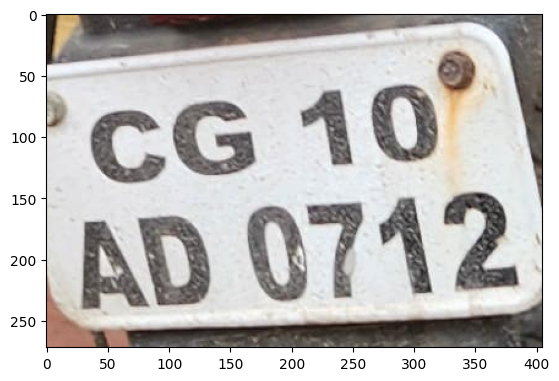

SDS


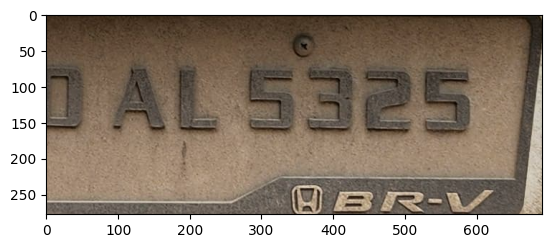

JAL5325


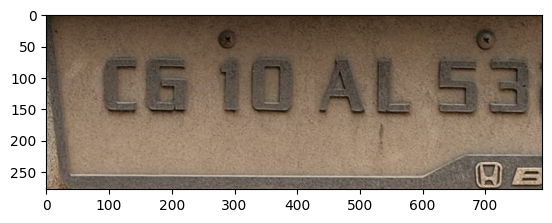

CSIDAL5A


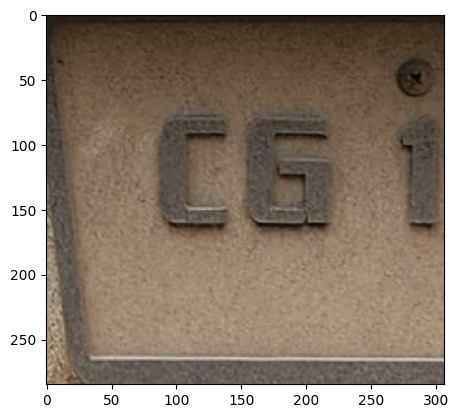

S


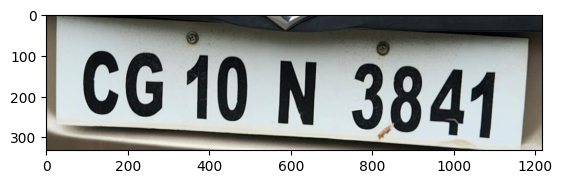

CG10N3841


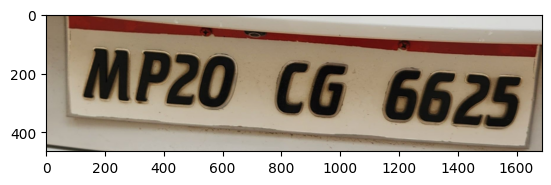

MP2066625


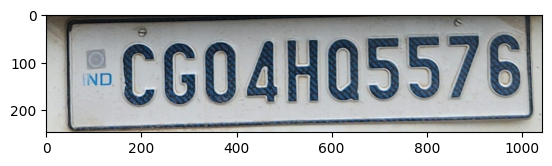

CGO4H05576


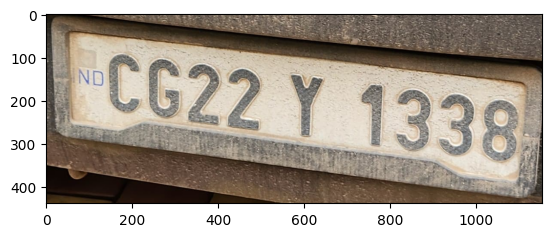

BEAVES


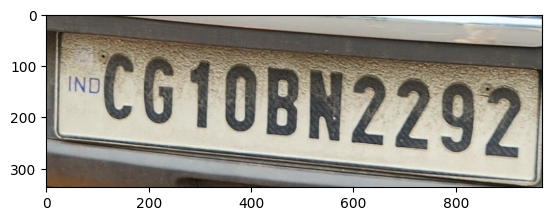

C610BN2292


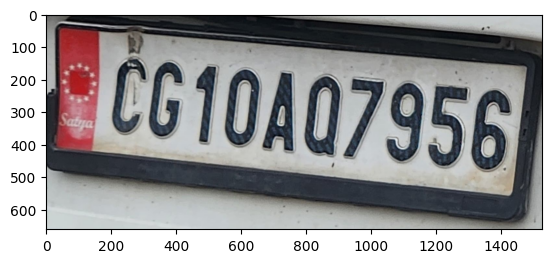

REG10A07956


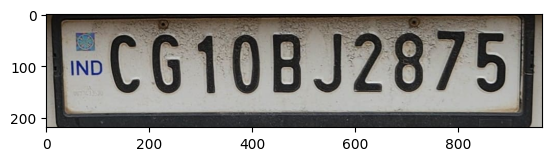

CG10BJ2875


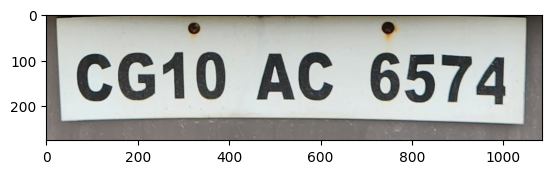

CG10AC6574


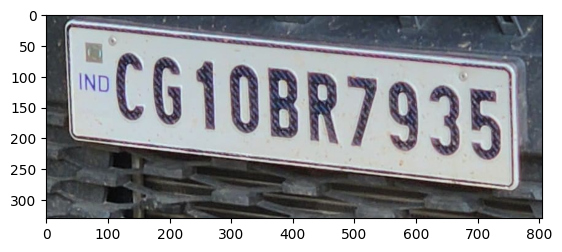

POSTINGRECEIPT


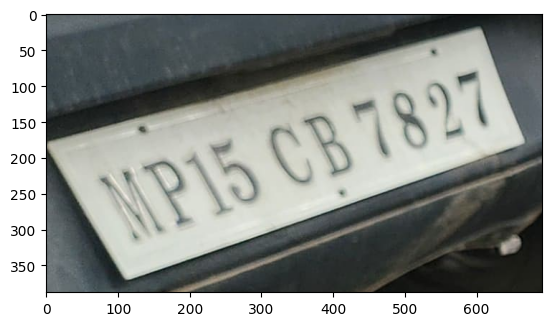

DISCOUNT


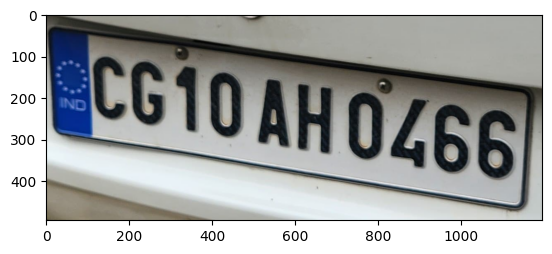

REG10AH0656


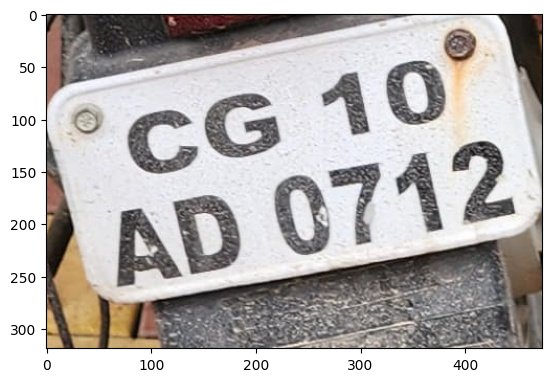

SD


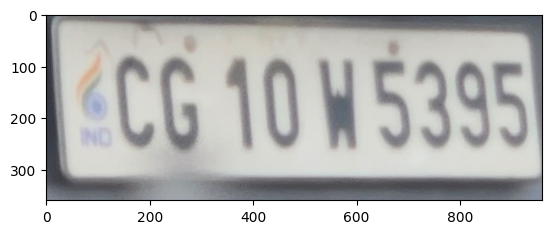

CG10W5395


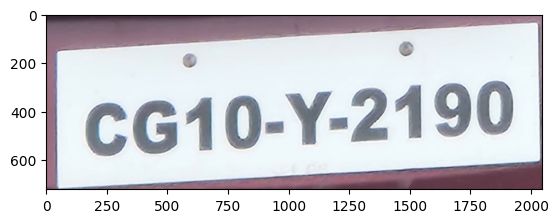

CG10Y2190


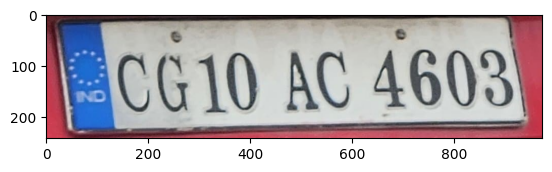

CGLIOAC4603


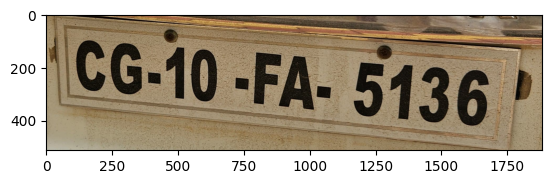

ICG10FA5136


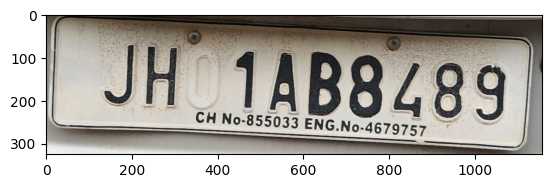

JH1AB8489


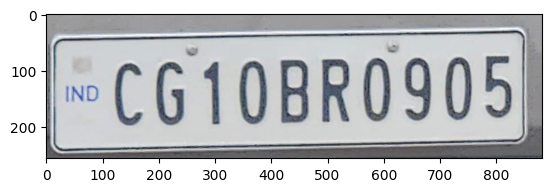

CG10BR0905


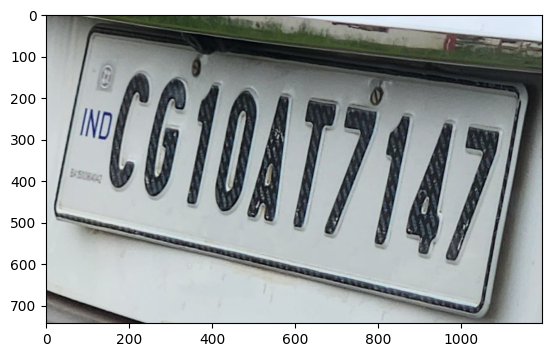

ECG10477167


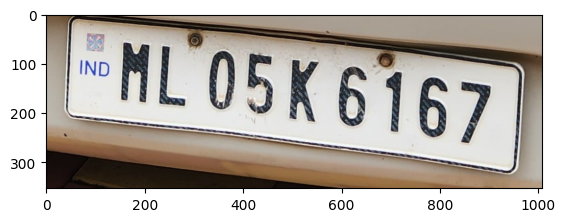

RM05K6167


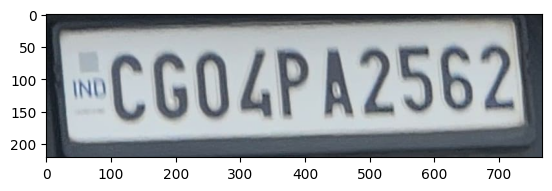

CGO4PA2562


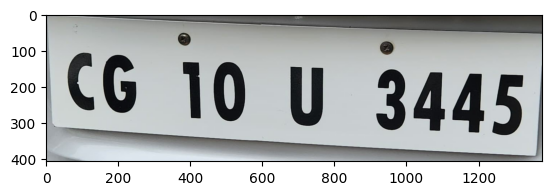

CG10U3445


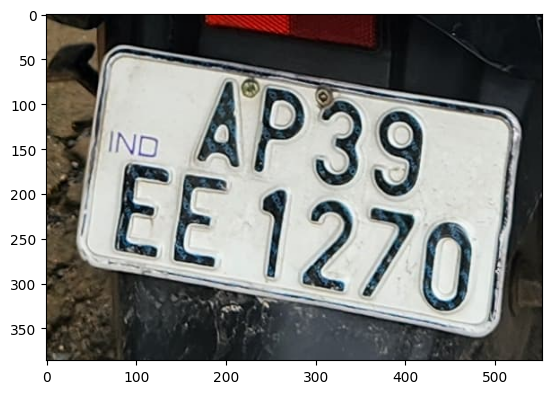

BARN


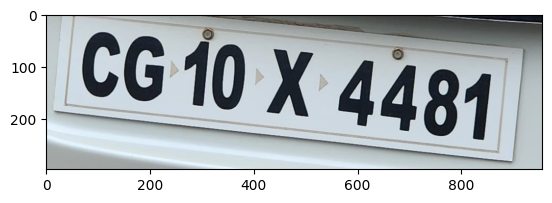

CG10X4481


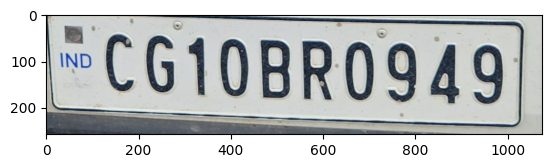

CG10BR0949


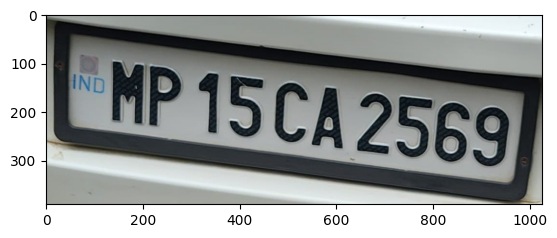

MP15CA2569


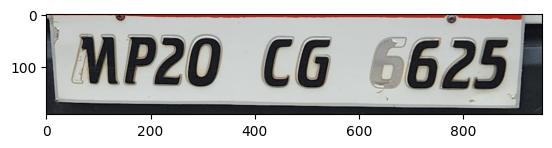

MP20C66625


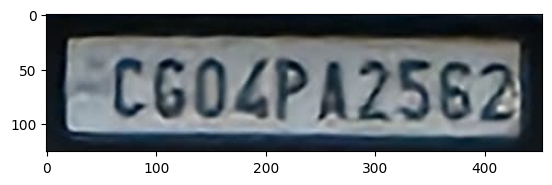

CG04PA2562


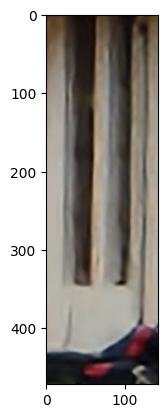

1


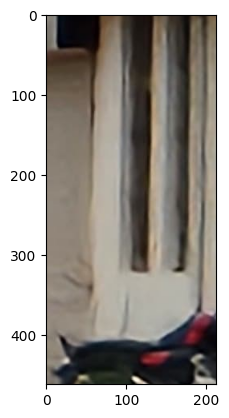

1


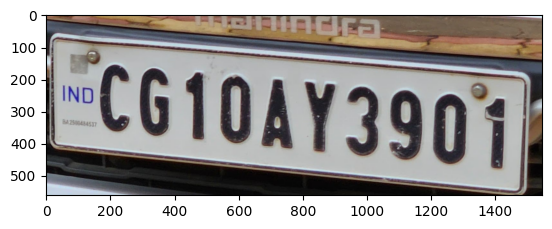

FC10AY3901


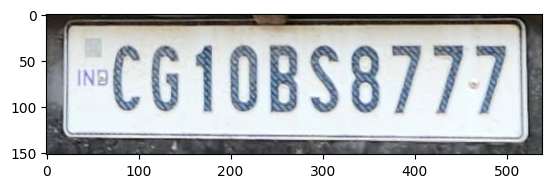

CG10BSR772


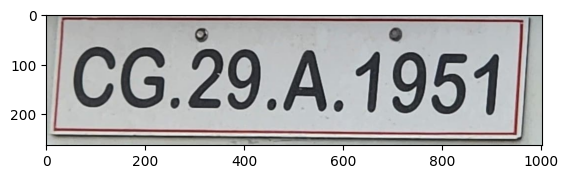

CG29A1951


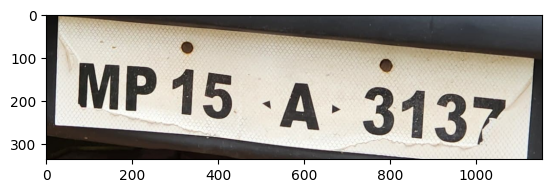

MP15A3137


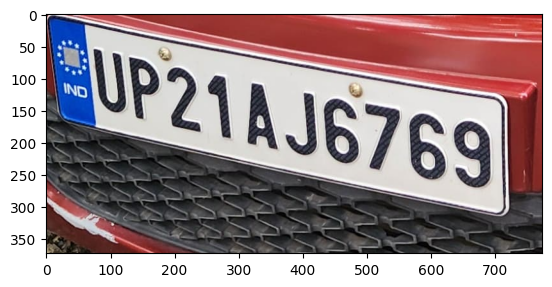

TAXINGGOST


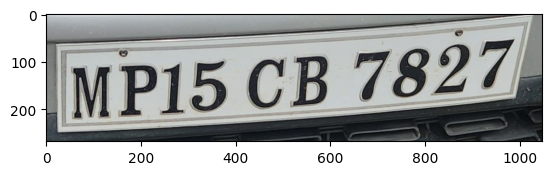

MP15CB7827


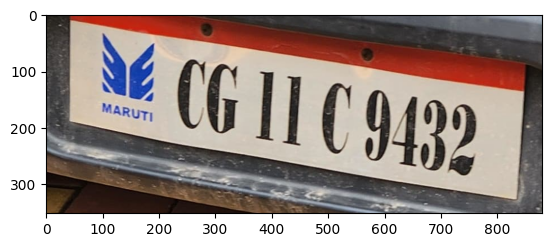

SECTION


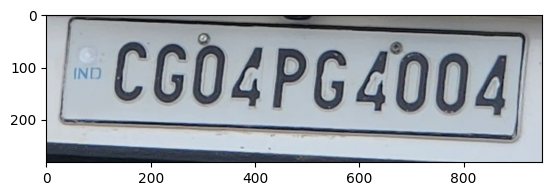

CG04PG4004


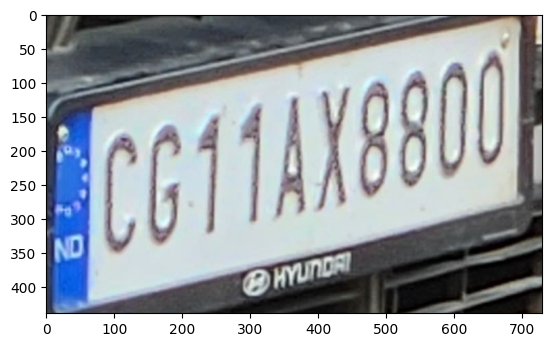

REG11AX8800


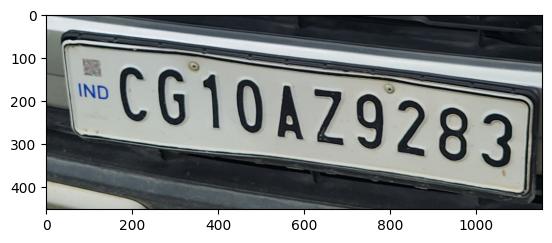

REG10A9283


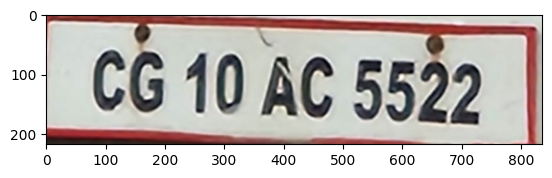

CG10AC5522


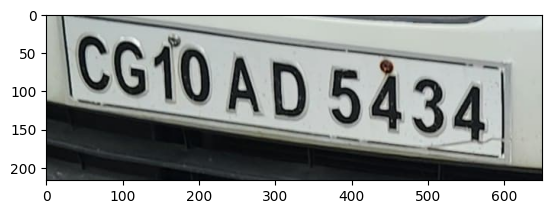

ICG10AD54341


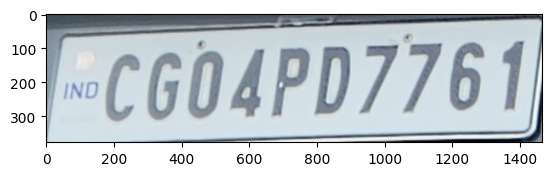

CG04PD7761


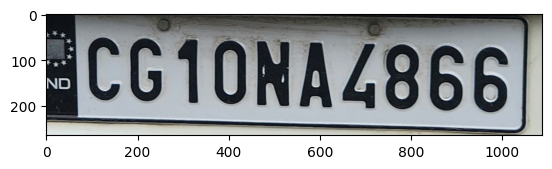

CG10NA4866


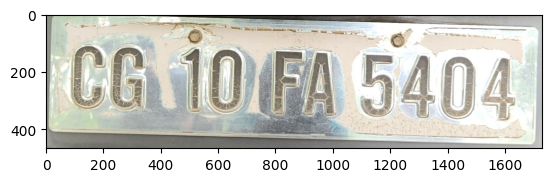

10EA5404


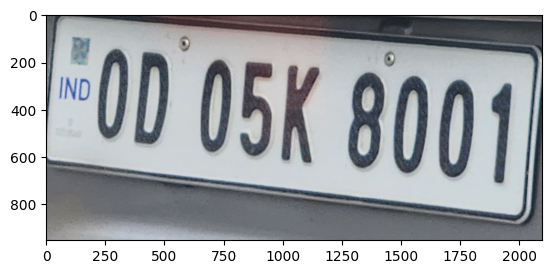

ROOD05K8001


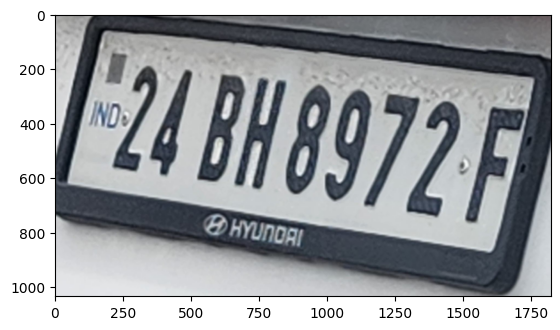

F24BH8972F


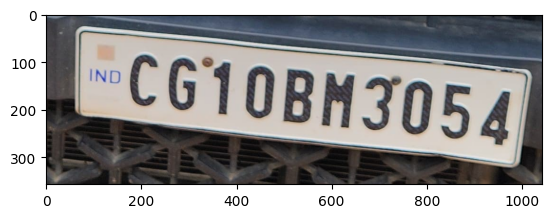

GST0030033


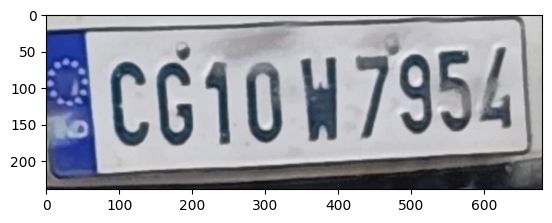

CG10W7954


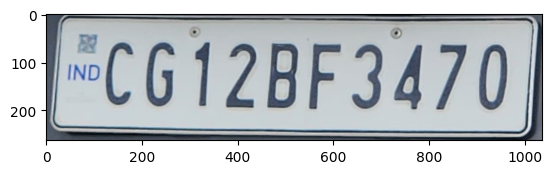

NCG12BF3470


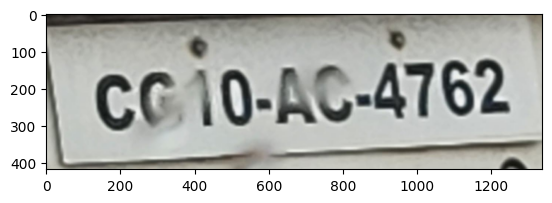

CG10AC4762


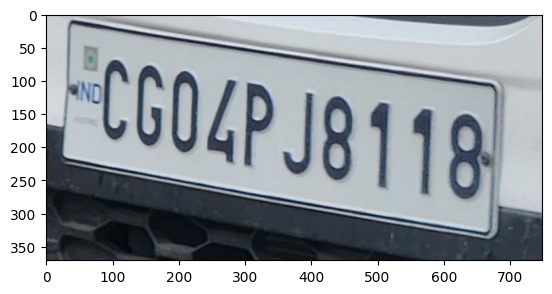

RECG04PJ8118


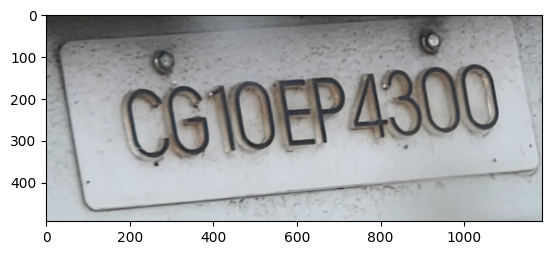

C60EP4300


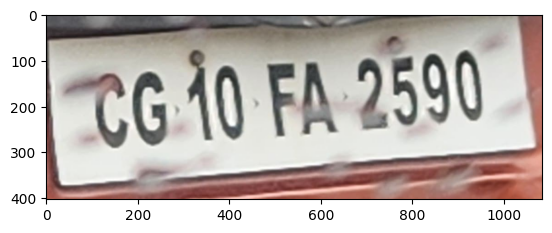

CG10FA2590


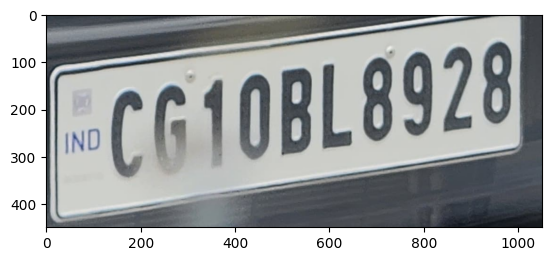

CF10BL8928


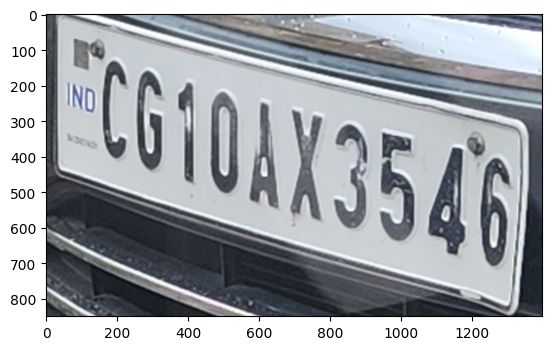

10610AX3546


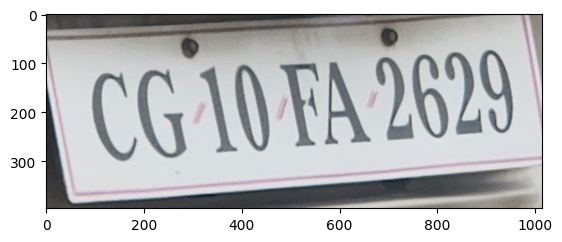

CG10FA2629


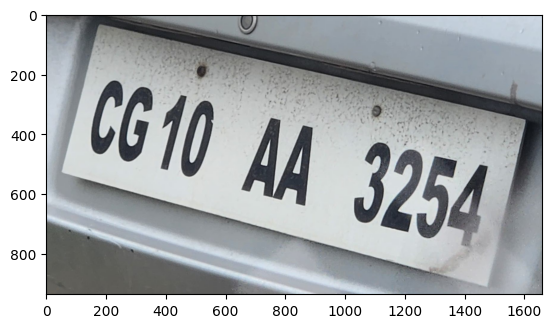

CG10AA3254


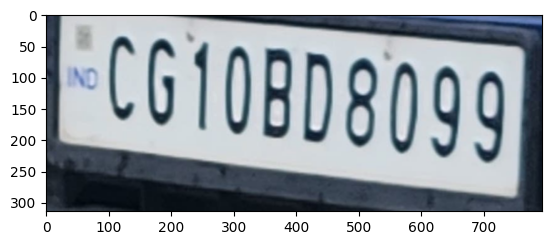

REG108D8099


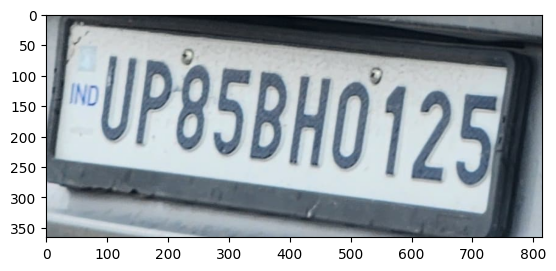

PUP85BHO125


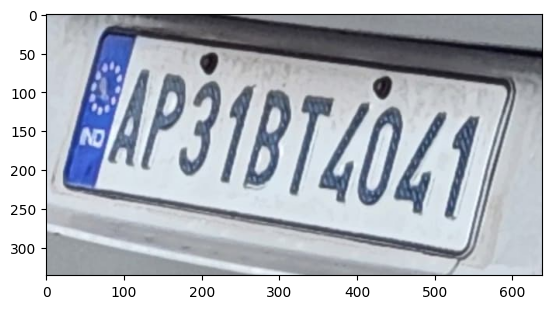

EMP31872041


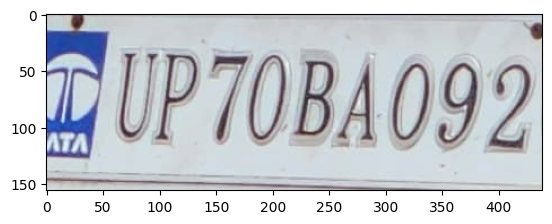

CUP70BA092


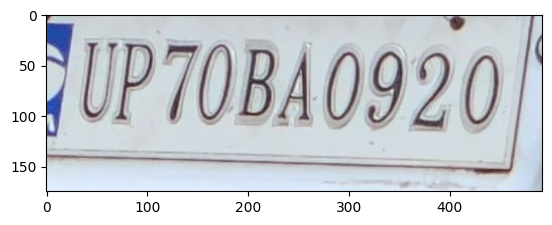

JUP70BA0920


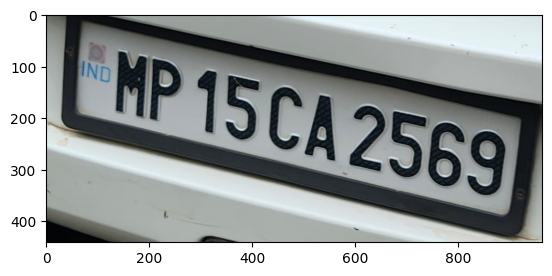

EMP15CA2569


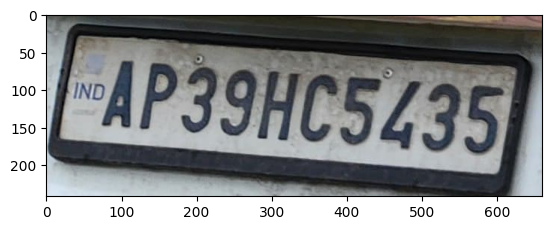

AP39HC535


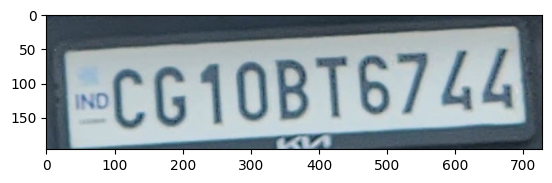

CG10BT6744


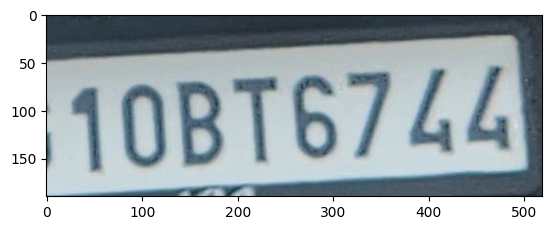

10BT6744


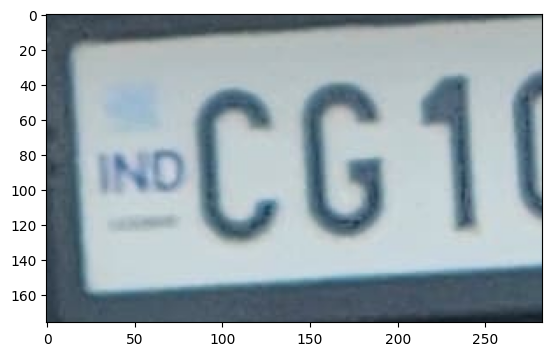

CG1


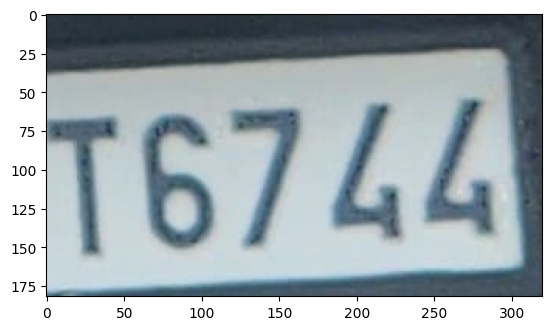

T6744


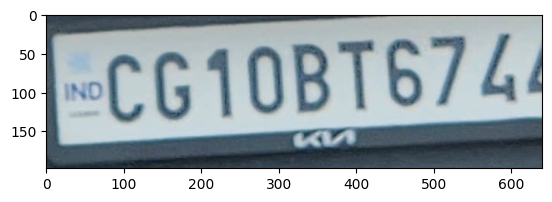

CG10BT6744


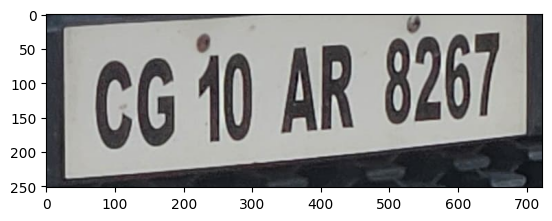

CG10AR8267


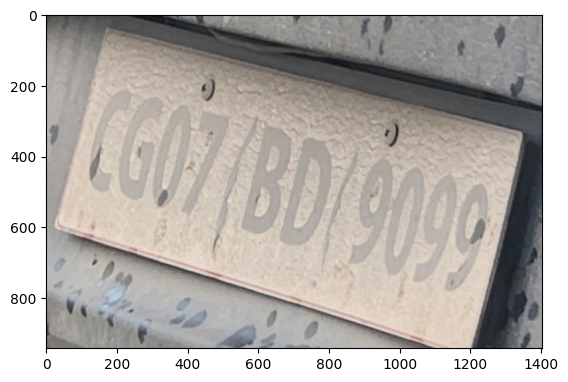

LOTED1099


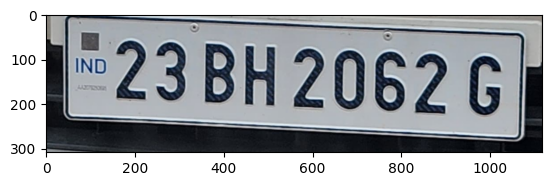

23BH2062G


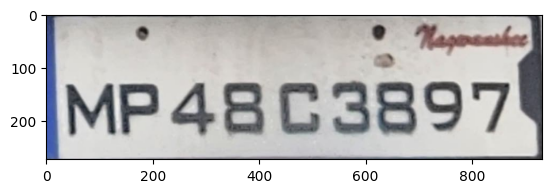

MP48C3897


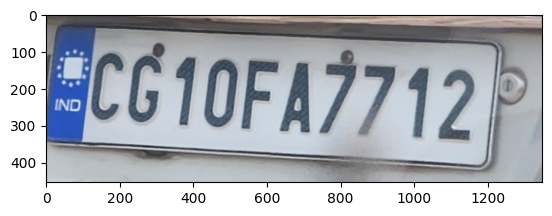

REG10FA7712P


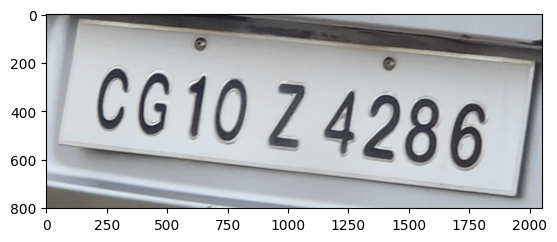

CG1024286


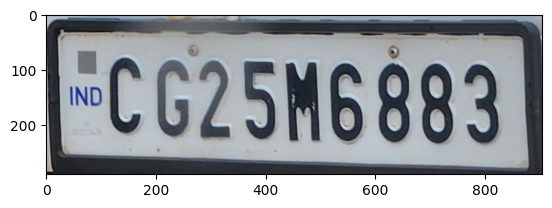

PCG25M6883


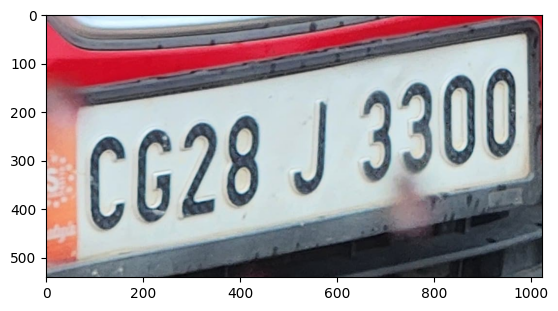

CG28J8800


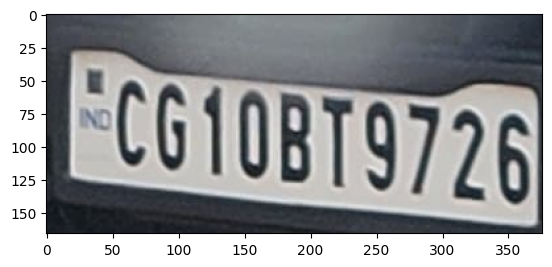

PCG10BT9726


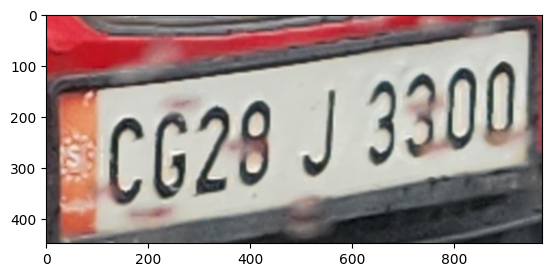

CG28J3300


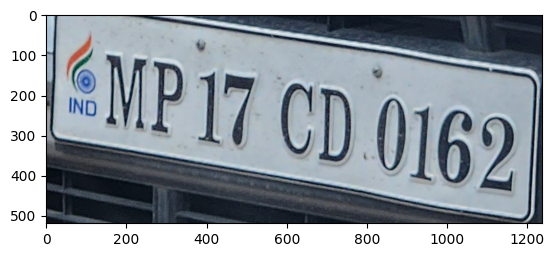

AMP17CP0162


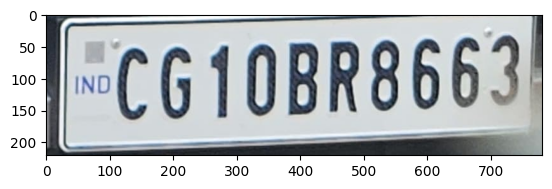

CG10BR8663


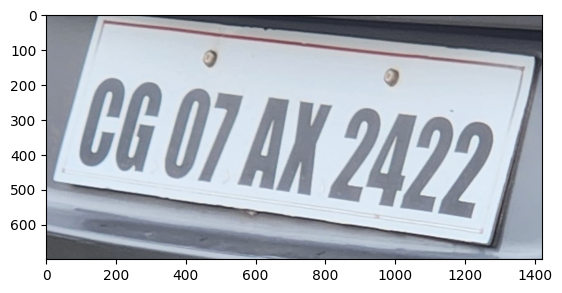

EC007AM2422


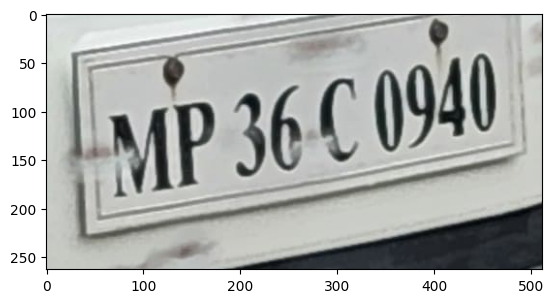

IMP36C0940


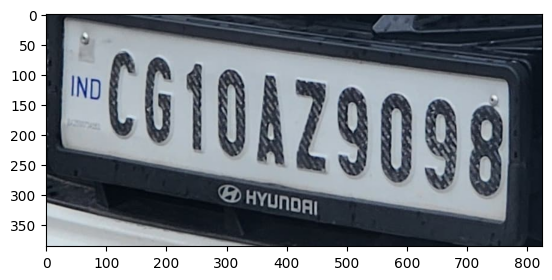

CO10479098


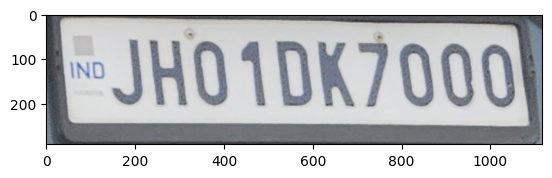

HJHO1DK7000


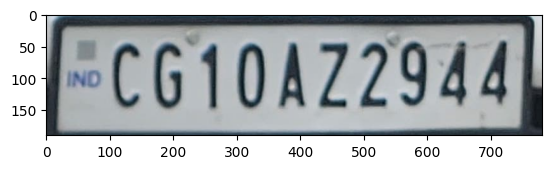

CG10AZ2944


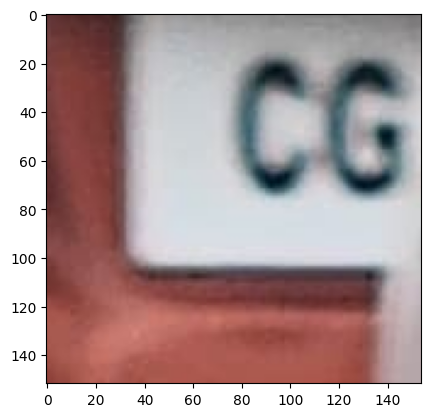

6


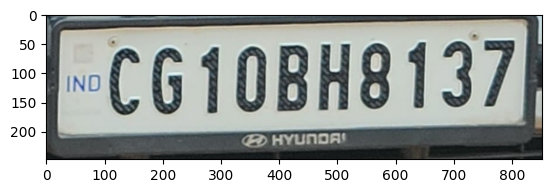

CG10BH8137


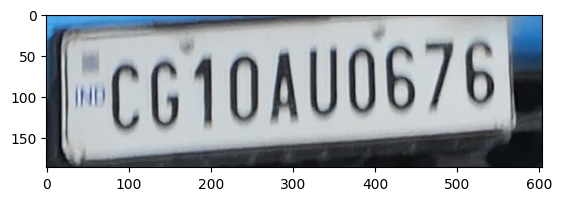

CG10AU0676


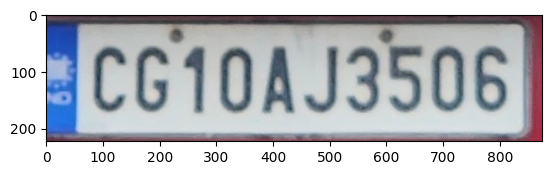

CG10AJ3506


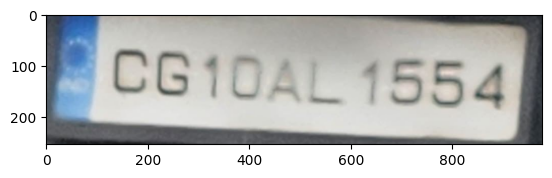

CG10AL1554


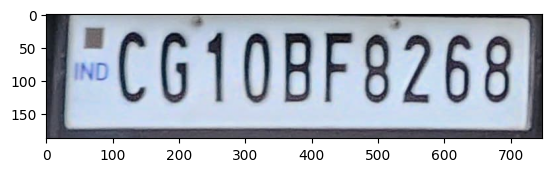

CG10BF8268


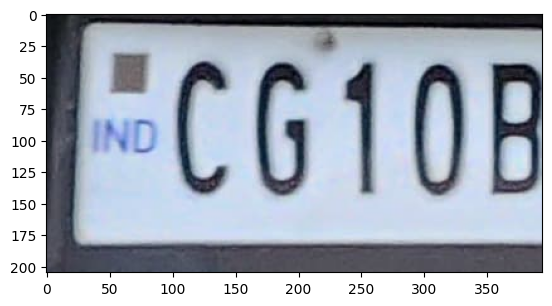

ECG10B


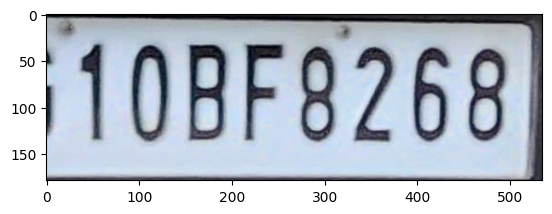

10BF8268


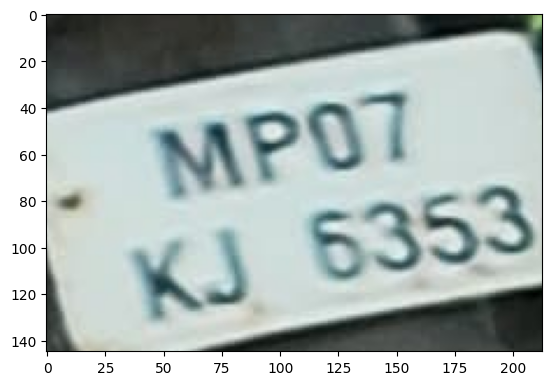

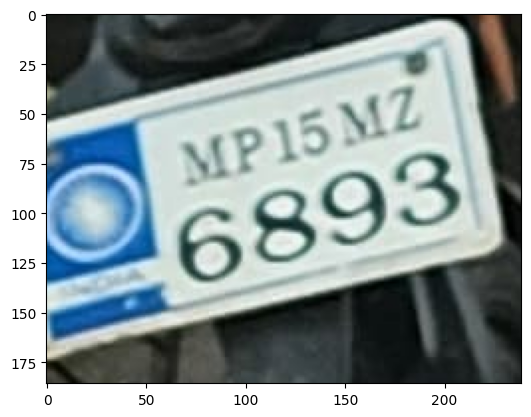

QTY


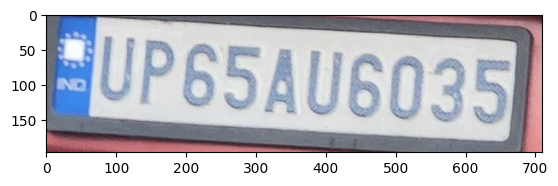

CUP65AU6035


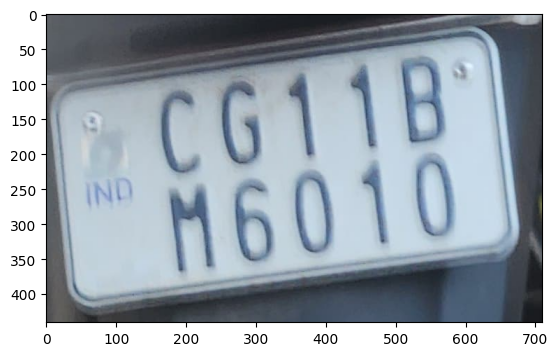

PERM


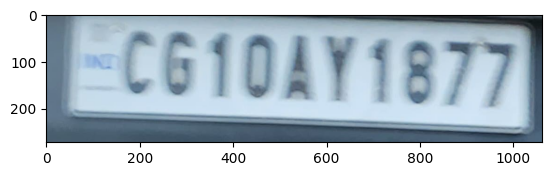

CG10AY1877


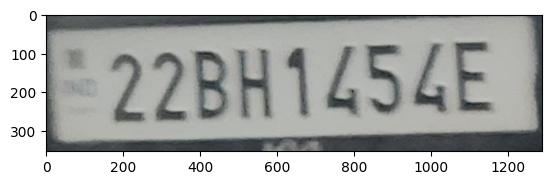

22BH1454E


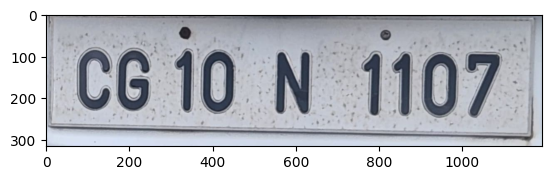

CG10N1107


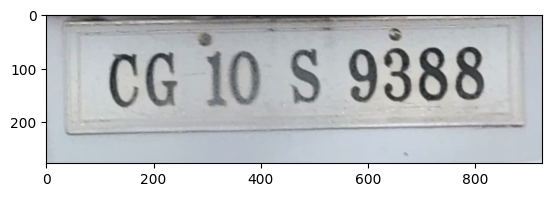

ICG10S9388


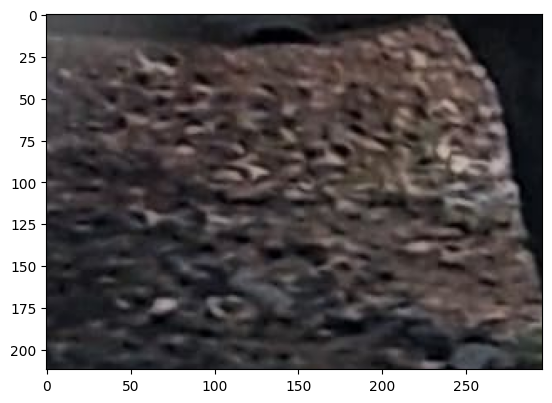

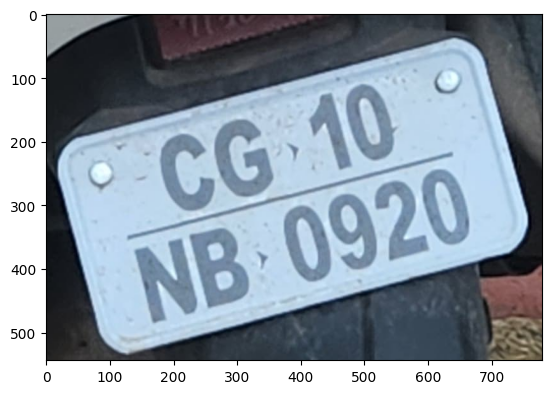

65593


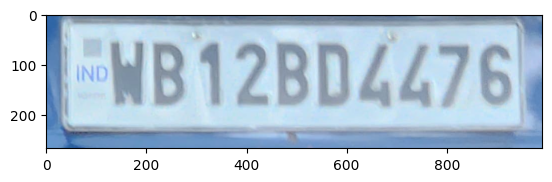

WEB12BD44761


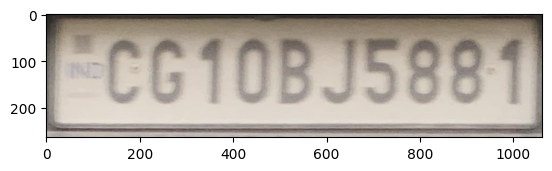

CG10BJ5881


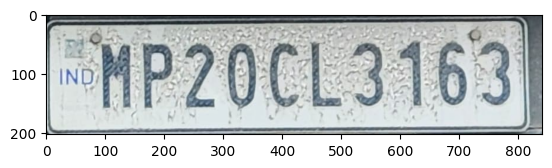

MP20CL3163


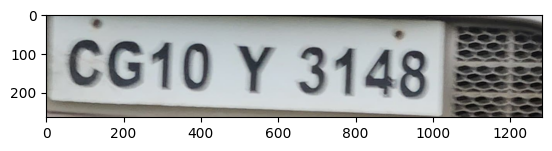

CG10Y3148


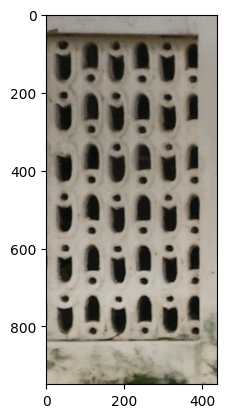

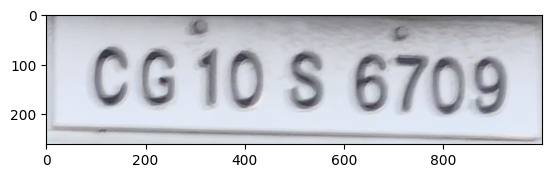

CG10S6709


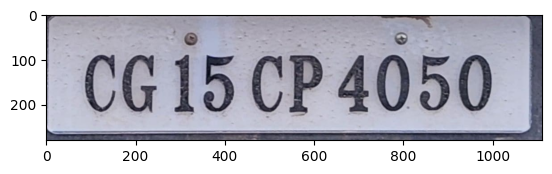

CG15CP4050


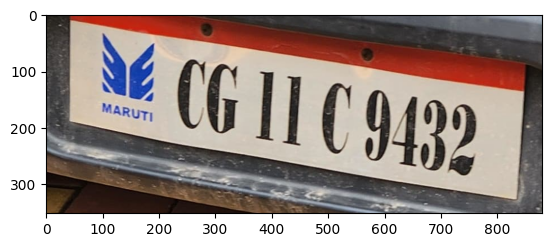

SECTION
0:01:03.973941


In [30]:
time=datetime.now()
number_plates=[]
for np in r:
    im=cv2.imread(np)
    
    plt.imshow(cv2.cvtColor(im,cv2.COLOR_RGB2BGR))
    plt.show()
    number_plates.append(extract_text(np))
print(datetime.now()-time)

In [31]:
74/128


0.578125

In [32]:
import pandas as pd

In [33]:
df=pd.DataFrame(columns=['image_file','Actual_RC','Detected_RC'])


In [34]:
for file,detected in zip(r,number_plates):
    df.loc[len(df.index)] = [file,'',detected]

FileNotFoundError: [Errno 2] No such file or directory: 'results/result20240806164539_0.txt'

In [36]:
df

,image_file,Actual_RC,Detected_RC
0,results/result20240806164539_0.png,,REF
1,results/result20240806164539_1.png,,THAN
2,results/result20240806164539_2.png,,0010722331
3,results/result20240806164539_3.png,,10722231
4,results/result20240806164539_4.png,,GST
...,...,...,...
120,results/result20240806164542_120.png,,CG10Y3148
121,results/result20240806164542_121.png,,
122,results/result20240806164542_122.png,,CG10S6709
123,results/result20240806164542_123.png,,CG15CP4050


In [37]:
df.to_excel('result.xlsx',index=False)

In [ ]:
# Speed: 1.9ms preprocess, 144.2ms inference, 0.6ms postprocess per image at shape (1, 3, 256, 320)

In [ ]:
def find_best_match(query, choices, score_cutoff=80):
    return process.extractOne(query, choices, score_cutoff=score_cutoff)

# Assuming the column with the codes is named 'Code'
all_codes = df['Code'].tolist()

# Incorrect entries
incorrect_entries = ['REG10A07956', 'C60EP4300']

# Correct entries
correct_entries = ['CG10A7956', 'CG08P4300']

# Find best matches
matches = []
for incorrect, correct in zip(incorrect_entries, correct_entries):
    best_match = find_best_match(correct, all_codes)
    if best_match:
        matches.append((incorrect, correct, best_match[0], best_match[1]))
    else:
        matches.append((incorrect, correct, None, None))

# Create a DataFrame with the results
results = pd.DataFrame(matches, columns=['Incorrect Entry', 'Correct Entry', 'Best Match', 'Match Score'])

print(results)

# Filter the original DataFrame to get the data for the best matches
matched_data = df[df['Code'].isin(results['Best Match'].dropna())]

print("\nMatched Data:")
print(matched_data)

In [40]:
import pandas as pd
from fuzzywuzzy import process



In [41]:
df=pd.read_excel('../../result.xlsx')

In [65]:
def find_best_match(query, choices, score_cutoff=50):
    return process.extractOne(query, choices, score_cutoff=score_cutoff)
all_number = df['Detected_RC']

In [72]:
find_best_match('C28J00',all_number)

('CG28J8800', 80, 89)

In [67]:
df['Detected_RC'][80]

'T6744'

In [69]:
process.extractBests('C28J00',all_number, score_cutoff=50)

[('CG28J8800', 80, 89), ('CG28J3300', 80, 91), ('IMP36C0940', 50, 95)]

In [70]:
 links = [f'<li><a href="/data/{i}">Data {i}</a></li>' for i in range(len(df))]

In [71]:
links

['<li><a href="/data/0">Data 0</a></li>',
 '<li><a href="/data/1">Data 1</a></li>',
 '<li><a href="/data/2">Data 2</a></li>',
 '<li><a href="/data/3">Data 3</a></li>',
 '<li><a href="/data/4">Data 4</a></li>',
 '<li><a href="/data/5">Data 5</a></li>',
 '<li><a href="/data/6">Data 6</a></li>',
 '<li><a href="/data/7">Data 7</a></li>',
 '<li><a href="/data/8">Data 8</a></li>',
 '<li><a href="/data/9">Data 9</a></li>',
 '<li><a href="/data/10">Data 10</a></li>',
 '<li><a href="/data/11">Data 11</a></li>',
 '<li><a href="/data/12">Data 12</a></li>',
 '<li><a href="/data/13">Data 13</a></li>',
 '<li><a href="/data/14">Data 14</a></li>',
 '<li><a href="/data/15">Data 15</a></li>',
 '<li><a href="/data/16">Data 16</a></li>',
 '<li><a href="/data/17">Data 17</a></li>',
 '<li><a href="/data/18">Data 18</a></li>',
 '<li><a href="/data/19">Data 19</a></li>',
 '<li><a href="/data/20">Data 20</a></li>',
 '<li><a href="/data/21">Data 21</a></li>',
 '<li><a href="/data/22">Data 22</a></li>',
 '<li><a

In [ ]:
find_best_match()